### Objetivo

> ATENÇÃO : Este notebook é exploratório.

Aqui foram avaliadas as possibilidades da identificação de emoções utilizando técnicas de [Topic Modeling](https://en.wikipedia.org/wiki/Topic_model). Na verdade, explorar a técnica de Topic Modeling de forma mais direcionada, levando em consideração a utilização das palavras emocionais dentro do texto e o contexto de cada uma.

Neste sentido, foram utilizadas técnicas já bem definidas e conhecidas, e até mesmo mais novas (como Word2Vec).

Abaixo, estão listados links de interesses para as técnicas utilizadas, como sendo a parte exploratória deste trabalho, será necessário ainda um melhor estudo e compreensão das correlações que todas as técnicas podem realmente ter entre si.


### Artigos
 - [An Efficient Method for Document Categorization Based on Word2vec and Latent Semantic Analysis](https://ieeexplore.ieee.org/abstract/document/7363382?reload=true)
 - [Mixing Dirichlet Topic Models and Word Embeddings to Make lda2vec](https://arxiv.org/abs/1605.02019)


### Functions
 - [TF-IDF](http://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html#sklearn.feature_extraction.text.TfidfVectorizer.fit)
 - [Word2Vec](https://radimrehurek.com/gensim/models/word2vec.html)
 - [SVD](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.TruncatedSVD.html)
 - [LDA](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.LatentDirichletAllocation.html)
 - [KMeans](http://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)
 - [t-SNE](https://lvdmaaten.github.io/tsne/)

### Tutorial
- **[Topic Modeling with LSA, PLSA, LDA & lda2Vec](https://medium.com/nanonets/topic-modeling-with-lsa-psla-lda-and-lda2vec-555ff65b0b05)**
- [In Depth: k-Means Clustering](https://jakevdp.github.io/PythonDataScienceHandbook/05.11-k-means.html)
- [Clustering US Laws using TF-IDF and K-Means](https://beckernick.github.io/law-clustering/)
- [The 5 Clustering Algorithms Data Scientists Need to Know](https://towardsdatascience.com/the-5-clustering-algorithms-data-scientists-need-to-know-a36d136ef68)

In [7]:
import sys
sys.path.append('../..')

import csv
import codecs
import copy
import re
from random import shuffle
from string import punctuation
from itertools import combinations
from itertools import cycle, islice

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.svm import SVC
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.manifold import TSNE
from sklearn.decomposition import TruncatedSVD, LatentDirichletAllocation
from sklearn.cluster import KMeans, MeanShift, DBSCAN, AffinityPropagation, estimate_bandwidth
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
import nltk
import spacy
import gensim
from gensim.models.phrases import Phrases, Phraser
from nltk import word_tokenize
from nltk.corpus import stopwords

import pylab as pl
from IPython import display

from utils import load_six_emotions, load_3_emotions


def softmax(x):
    """Compute softmax values for each sets of scores in x."""
    return np.exp(x) / np.sum(np.exp(x), axis=0)

def is_number(s):
    try:
        complex(s) # for int, long, float and complex
    except ValueError:
        return False
    return True

def _get_stopwords():
    stpwords = stopwords.words('portuguese') + list(punctuation)
    rms = ['um', 'não', 'mais', 'muito']
    for rm in rms:
        del stpwords[stpwords.index(rm)]
    return stpwords

def tokenizer(phrase):
    phrase = phrase.lower()
    for o, r in RM:
        phrase = re.sub(o, r, phrase, flags=re.MULTILINE)
    phrase = NLP(re.sub(r'["\'@#%\(\)]', '', phrase), disable=['parser'])
    clean_frase = []
    for palavra in phrase:
        if palavra.pos_ != 'PUNCT':
            word = palavra.text.strip()
            if not is_number(word) and word not in STOPWORDS and len(word) > 1:
                clean_frase += [STEMMER.stem(palavra.text)]
    return ' '.join(clean_frase)


def make_meshgrid(x, y, h=.02):
    """Create a mesh of points to plot in

    Parameters
    ----------
    x: data to base x-axis meshgrid on
    y: data to base y-axis meshgrid on
    h: stepsize for meshgrid, optional

    Returns
    -------
    xx, yy : ndarray
    """
    x_min, x_max = x.min() - 1, x.max() + 1
    y_min, y_max = y.min() - 1, y.max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))
    return xx, yy

# GLOBALS
NLP = spacy.load('pt')
# STEMMER = nltk.stem.RSLPStemmer()
STEMMER = nltk.stem.SnowballStemmer('portuguese')
STOPWORDS = _get_stopwords()
RM = [
    ('\n', '. '), ('"', ''), ('@', ''),
    ('#', ''), ('RT', ''), (r'(http[s]*?:\/\/)+.*[\r\n]*', '')
]

np.random.seed(12345)

%matplotlib inline

In [8]:
frases_felicidade = [
    ('Quando a tristeza bater na sua porta, abra um belo sorriso e diga: Desculpa, mas hoje a felicidade chegou primeiro!', 'FELICIDADE'),
    ('Minha meta é ser feliz, não perfeito.', 'FELICIDADE'),
    ('Que a felicidade vire rotina.', 'FELICIDADE'),
    ('Felicidade é saber aproveitar todos os momentos como se fossem os últimos.', 'FELICIDADE'),
    ('Eu não quero esperar até o final para ser feliz. Eu quero é ser feliz agora.', 'FELICIDADE'),
    ('Hoje estou muito feliz!', 'FELICIDADE'),
    ('O dia esta excelente, estou muito feliz.', 'FELICIDADE'),
    ('Abra um sorriso, que a felicidade chegou.', 'FELICIDADE'),
    ('Como estou feliz, desejo que a felicidade invade seu coração', 'FELICIDADE'),
    ('Estou sorrindo... você não percebe como estou feliz.', 'FELICIDADE'),
    ('Saber encontrar a alegria na alegria dos outros, é o segredo da felicidade.', 'FELICIDADE'),
    ('A alegria de fazer o bem é a única felicidade verdadeira.', 'FELICIDADE'),
    ('Na plenitude da felicidade, cada dia é uma vida inteira.', 'FELICIDADE'),
    ('As ideias das pessoas são pedaços da sua felicidade.', 'FELICIDADE'),
    ('O segredo da felicidade é encontrar a nossa alegria na alegria dos outros.', 'FELICIDADE'),
]

frases_tristeza = [
    ('O maior problema em acreditar nas pessoas erradas, é que um dia você acaba não acreditando em mais ninguém.', 'TRISTEZA'),
    ('Não me deixe ir, posso nunca mais voltar.', 'TRISTEZA'),
    ('Prefiro que enxerguem em mim erros com arrependimento do que uma falsa perfeição.', 'TRISTEZA'),
    ('A morte é uma pétala que se solta da flor e deixa uma eterna saudade no coração.', 'TRISTEZA'),
    ('Partiu para não mais voltar, e meu coração se partiu para não mais se recompor. Saudades de quem a morte levou para sempre.', 'TRISTEZA'),
    ('Luto é o tempo necessário para a mente entender o sentimento de perda que o coração já sente.', 'TRISTEZA'),
    ('Suas memórias são meu maior tesouro. Saudades suas, meu pai!', 'TRISTEZA'),
    ('Meu amigo se foi para sempre. No seu lugar ficaram estas saudades eternas, que eternamente serão sentidas com muita tristeza.', 'TRISTEZA'),
    ('Hoje o sol não brilhou, os pássaros não cantaram, os risos se calaram e as lágrimas rolaram em meu rosto. Meu coração sofre em silêncio.', 'TRISTEZA'),
    ('Lágrimas não doem, o que dói é o motivo que as fazem cair.', 'TRISTEZA'),
    ('A dor de perder um filho, é um sentimento muito triste e ruim.', 'TRISTEZA'),
    ('Não há solidão mais triste do que a do homem sem amizades. A falta de amigos faz com que o mundo pareça um deserto.', 'TRISTEZA'),
    ('A árvore quando está sendo cortada, observa com tristeza que o cabo do machado é de madeira.', 'TRISTEZA'),
    ('Cuidado com a tristeza. Ela é um vício.', 'TRISTEZA'),
    ('É triste pensar que a natureza fala e que o gênero humano não a ouve.', 'TRISTEZA'),
    ('A ganância insaciável é um dos tristes fenómenos que apressam a autodestruição do homem.', 'TRISTEZA'),
]

frases_amor = [
    ('Duvide do brilho das estrelas. Duvide do perfume de uma flor. Duvide de todas as verdades. Mas nunca duvide do meu amor.', 'AMOR'),
    ('Amar é cuidar um do outro mesmo quando estamos zangados.', 'AMOR'),
    ('O amor só é lindo, quando encontramos alguém que nos transforme no melhor que podemos ser.', 'AMOR'),
    ('Quando o amor é verdadeiro, a distância vira mero detalhe.', 'AMOR'),
    ('Não escolha a pessoa mais bonita do mundo. Escolha a pessoa que faz do seu mundo o mais bonito.', 'AMOR'),
    ('Pensando em você, me torno um poeta, olhando você, me torno um artista, imaginando nosso amor, me torno um sonhador', 'AMOR'),
    ('Sinto que meu amor por você cresce a cada dia.', 'AMOR'),
    ('Só o seu amor me faz cresce, te amo demais linda!', 'AMOR'),
    ('A amizade é um amor que nunca morre.', 'AMOR'),
    ('Lutar pelo amor é bom, mas alcançá-lo sem luta é melhor.', 'AMOR'),
    ('Aquilo que se faz por amor está sempre além do bem e do mal.', 'AMOR'),
    ('As mais lindas palavras de amor são ditas no silêncio de um olhar.', 'AMOR'),
    ('O verdadeiro amor nunca se desgasta. Quanto mais se dá mais se tem.', 'AMOR'),
    ('Se o amor é fantasia, eu me encontro ultimamente em pleno carnaval.', 'AMOR'),
    ('Amai, porque nada melhor para a saúde que um amor correspondido.', 'AMOR'),
    ('O amor não se vê com os olhos mas com o coração.', 'AMOR'),
    ('A medida do amor é amar sem medida.', 'AMOR'),
    ('Como são sábios aqueles que se entregam às loucuras do amor!', 'AMOR'),
]


original_tweets = []
sents1 = []
sents2 = []
filename = '/home/rdenadai/vagrant/python-dev/sentiment-analysis-2018-president-election/dataset/50_tweets_mg.csv'
with codecs.open(filename, encoding="utf-8") as h:
    reader = csv.reader(h, delimiter='|')
    for row in reader:
        tweet = row[1]
        tweet_sent1 = row[2].upper()
        tweet_sent2 = row[3].upper()
        for o, r in RM:
            tweet = re.sub(o, r, tweet, flags=re.MULTILINE)
        if len(tweet) > 5:
            original_tweets += [tweet]
            sents1 += [tweet_sent1]
            sents2 += [tweet_sent2]

tweets = []
for tweet in original_tweets:
    tweets.append(tokenizer(tweet))
ltweets = [f'D{i}' for i in range(len(tweets))]

In [9]:
frases_felicidade_parsed = []
frases_tristeza_parsed = []
frases_amor_parsed = []
frases_felicidade_sentimento = []
frases_tristeza_sentimento = []
frases_amor_sentimento = []

# dc = NLP('é que um dia você acaba não acreditando em mais ninguém', disable=['parser'])
# print([(w.text, w.pos_, w.lemma_) for w in dc])

for frase, sentimento in frases_felicidade:
    frases_felicidade_parsed.append(tokenizer(frase))
    frases_felicidade_sentimento.append(sentimento)

for frase, sentimento in frases_tristeza:
    frases_tristeza_parsed.append(tokenizer(frase))
    frases_tristeza_sentimento.append(sentimento)

for frase, sentimento in frases_amor:
    frases_amor_parsed.append(tokenizer(frase))
    frases_amor_sentimento.append(sentimento)

print(frases_felicidade_parsed)
print(frases_tristeza_parsed)
print(frases_amor_parsed)

frases = frases_felicidade_parsed + frases_tristeza_parsed + frases_amor_parsed + tweets
ldocs = [f'D{i}' for i in range(len(frases))]

['tristez bat port abra um bel sorris dig desculp hoj felic cheg primeir', 'met ser feliz nã perfeit', 'felic vir rotin', 'felic sab aproveit tod moment últim', 'nã quer esper final ser feliz quer ser feliz agor', 'hoj muit feliz', 'dia excelent muit feliz', 'abra um sorris felic cheg', 'feliz desej felic invad coraçã', 'sorr nã perceb feliz', 'sab encontr alegr alegr outr segred felic', 'alegr faz bem únic felic verdadeir', 'plenitud felic cad dia vid inteir', 'ide pesso pedac felic', 'segred felic encontr alegr alegr outr']
['maior problem acredit pesso errad um dia acab nã acredit mais ninguém', 'nã deix ir poss nunc mais volt', 'prefir enxergu mim erros arrepend fals perfeiçã', 'mort pétal solt flor deix etern saudad coraçã', 'part nã mais volt coraçã part nã mais recompor saudad mort lev sempr', 'lut temp necessári ment entend sentiment perd coraçã sent', 'memór maior tesour saudad pai', 'amig sempr lug fic saudad etern etern sent muit tristez', 'hoj sol nã brilh pássar nã cant ri

In [10]:
vec_tfidf = TfidfVectorizer(ngram_range=(1, 1))
X_tfidf = vec_tfidf.fit_transform(frases)

N_features = X_tfidf.shape[1]

frases_w2v = []
for frase in frases:
    bigram = []
    p_frase = word_tokenize(frase)
    for m, palavra in enumerate(p_frase):
        next_p = None
        try:
            next_p = p_frase[m+1]
        except:
            pass
        bigram += [f'{palavra}']
#         if next_p:
#             bigram += [f'{palavra} {next_p}']
    frases_w2v += [bigram]

model = gensim.models.Word2Vec(
    frases_w2v,
    sg=1,
    # size=N_features,
    size=1,
    window=50,
    min_count=1,
    workers=10)
model.train(frases_w2v, total_examples=len(frases_w2v), epochs=1500)

vec_count = CountVectorizer(ngram_range=(1, 1))
X_count = vec_count.fit_transform(frases)
weights_count = pd.DataFrame(np.round(X_count.toarray().T, 5), index=vec_count.get_feature_names(), columns=ldocs)

print(X_tfidf.shape)
print(X_count.shape)
print(model.wv.vectors.shape)

# X_tfidf = X_tfidf + X_count
# X_tfidf = np.asarray(np.dot(X_tfidf.toarray(), model.wv.vectors))
# X_tfidf = np.asarray(np.dot(X_tfidf.toarray(), model.wv.vectors))
X_tfidf = X_tfidf.toarray()

print("   Actual number of tfidf features: %d" % N_features)
weights_tfidf = pd.DataFrame(np.round(X_tfidf.T, 5), index=vec_tfidf.get_feature_names(), columns=ldocs)
# display(weights_tfidf.head(15))
print(weights_tfidf.head(15))

(99, 466)
(99, 466)
(467, 1)
   Actual number of tfidf features: 466
                D0   D1   D2   D3       D4   D5   D6       D7   D8   D9  \
16         0.00000  0.0  0.0  0.0  0.00000  0.0  0.0  0.00000  0.0  0.0   
452        0.00000  0.0  0.0  0.0  0.00000  0.0  0.0  0.00000  0.0  0.0   
56         0.00000  0.0  0.0  0.0  0.00000  0.0  0.0  0.00000  0.0  0.0   
764        0.00000  0.0  0.0  0.0  0.00000  0.0  0.0  0.00000  0.0  0.0   
770        0.00000  0.0  0.0  0.0  0.00000  0.0  0.0  0.00000  0.0  0.0   
abra       0.28382  0.0  0.0  0.0  0.00000  0.0  0.0  0.50627  0.0  0.0   
abrac      0.00000  0.0  0.0  0.0  0.00000  0.0  0.0  0.00000  0.0  0.0   
acab       0.00000  0.0  0.0  0.0  0.00000  0.0  0.0  0.00000  0.0  0.0   
acredit    0.00000  0.0  0.0  0.0  0.00000  0.0  0.0  0.00000  0.0  0.0   
administr  0.00000  0.0  0.0  0.0  0.00000  0.0  0.0  0.00000  0.0  0.0   
advocac    0.00000  0.0  0.0  0.0  0.00000  0.0  0.0  0.00000  0.0  0.0   
aeronav    0.00000  0.0  0.0  0

In [11]:
alegria = ['feliz', 'felicidade', 'sorriso', 
           'perfeito', 'belo', 'excelente', 'perfeição', 
           'amor', 'verdadeiro', 'verdade', 'cuidar', 'lindo', 'tesouro']
alegria += ['abundante', 'acalmar', 'aceitável', 'aceitação', 'aclamar', 'aconchego', 'adesão', 'admirar', 'adorar', 'adoração', 'afeição', 'afeto', 'afetividade', 'afortunado', 'afável', 'agradar', 'ajeitar', 'altivez', 'altivo', 'alívio', 'amabilidade', 'amado', 'amar', 'amenizar', 'ameno', 'amigável', 'amistoso', 'amizade', 'amor', 'amável', 'animação', 'anseio', 'ansioso', 'apaixonado', 'apaziguar', 'aplausos', 'apoiar', 'aprazer', 'apreciar', 'aprovação', 'aproveitar', 'ardor', 'armirar', 'arrumar', 'atraente', 'atrair', 'atração', 'avidamente', 'avidez', 'belo', 'beleza', 'bem-estar', 'beneficiador', 'beneficência', 'benefício', 'benevocência', 'benignamente', 'benéfico', 'benígno', 'boa-intenção', 'bom', 'bom-humor', 'bondade', 'bondoso', 'bonito', 'bravura', 'brilhante', 'brilhantismo', 'brincadeira', 'brio', 'calma', 'calor', 'caridade', 'caridoso', 'carinho', 'cativar', 'charme', 'cheery', 'clamar', 'cofortar', 'coleguismo', 'comover', 'compaixão', 'companheirismo', 'compatibilidade', 'compatível', 'complacência', 'completar', 'compreensão', 'comédia', 'conclusão', 'concretização', 'condescendência', 'confiança', 'confortante', 'congratulação', 'conquistar', 'consentir', 'considerar', 'consideração', 'consolação', 'consolo', 'contentamento', 'contente', 'coragem', 'cordial', 'cuidadoso', 'cumplicidade', 'cômico', 'dedicação', 'deleitado', 'delicadamente', 'delicadeza', 'delicado', 'desejar', 'despreocupação', 'devoto', 'devoção', 'dignidade', 'diversão', 'divertido', 'elogiado', 'emocionante', 'emotivo', 'emoção', 'empatia', 'empolgação', 'empático', 'enamorar', 'encantado', 'encantar', 'encorajado', 'enfeitar', 'engraçado', 'entendimento', 'entusiasmadamente', 'entusiástico', 'esperança', 'esplendor', 'estima', 'estimar', 'estimulante', 'euforia', 'euforizante', 'eufórico', 'exaltar', 'excelente', 'excitar', 'expansivo', 'extasiar', 'exuberante', 'exultar', 'facilitar', 'familiaridade', 'fascinação', 'fascínio', 'favor', 'favorecer', 'favorito', 'felicidade', 'feliz', 'festa', 'festejar', 'festivo', 'fidelidade', 'fiel', 'filantropia', 'filantrópico', 'fraterno', 'fã', 'ganhar', 'generosidade', 'generoso', 'gentil', 'glorificar', 'glória', 'gostar', 'gostoso', 'gozar', 'gratidão', 'gratificante', 'gratificação', 'grato', 'hilariante', 'honra', 'humor', 'impressionar', 'incentivar', 'incentivo', 'inclinação', 'incrível', 'inspirar', 'interessar', 'interesse', 'irmandade', 'jovial', 'jovialidade', 'jubilante', 'júbilo', 'lealdade', 'legítimo', 'leveza', 'louvar', 'louvavelmente', 'louvável', 'lucrativo', 'lucro', 'majestoso', 'maravilhoso', 'melhor', 'namoro', 'nobre', 'obter', 'obteve', 'ode', 'orgulho', 'orgulhoso', 'paixão', 'parabenizar', 'paz', 'piedoso', 'positivo', 'prazenteiro', 'prazer', 'predileção', 'preencher', 'preferido', 'preferência', 'promissor', 'prosperidade', 'proteger', 'protetor', 'proteção', 'proveito', 'provilégio', 'querer', 'radiante', 'realizar', 'recomendável', 'recompensa', 'reconhecer', 'recrear', 'recreativo', 'recreação', 'regozijar', 'respeitar', 'ressuscitar', 'revigorar', 'risada', 'risonho', 'romantismo', 'romântico', 'saciar', 'saciável', 'satisfatoriamente', 'satisfatório', 'satisfazer', 'satisfação', 'satisfeito', 'seduzir', 'sedução', 'sereno', 'simpaticamente', 'simpático', 'sobreviver', 'sobrevivência', 'sorte', 'sortudo', 'sucesso', 'surpreender', 'tenro', 'ternura', 'torcer', 'tranquilo', 'triunfal', 'triunfante', 'triunfo', 'vanglória', 'vantagem', 'vantajoso', 'vencedor', 'veneração', 'ventura', 'vida', 'vigor', 'virtude', 'virtuoso', 'vitorioso', 'vitória', 'viver', 'vivo', 'zelo', 'zeloso', 'ávido', 'ânimo', 'ânsia', 'tesouro']
alegria = list(set(alegria))
tristeza = ['tristeza', 'problema', 'arrependimento', 'errar', 
            'não', 'falsa', 'morte', 'saudade', 'luto', 'distância', 
            'perda', 'memórias', 'dúvida', 'dói', 'lágrimas']
tristeza += ['abandonado', 'abandonar', 'abater', 'abatido', 'abatimento', 'abominável', 'aborrecer', 'aborrecimento', 'abortar', 'aceitação', 'adversidade', 'adverso', 'afastamento', 'afligir', 'aflito', 'aflição', 'agoniado', 'agoniar', 'amargo', 'amargor', 'amargura', 'amargurado', 'angustiado', 'angústia', 'ansiedade', 'apartado', 'arrepender', 'arrependidamente', 'arrependido', 'arrependimento', 'atormentado', 'atrito', 'azar', 'cabisbaixo', 'carrancudo', 'castigar', 'castigo', 'chorar', 'choro', 'choroso', 'chorão', 'circunspecção', 'circunspeção', 'coitado', 'compassivo', 'compungido', 'compunção', 'consternado', 'consternação', 'contristador', 'contrito', 'contrição', 'culpa', 'defeituoso', 'degradante', 'deplorável', 'deposição', 'depravado', 'depressivo', 'depressão', 'deprimente', 'deprimido', 'deprimir', 'derrota', 'derrubar', 'desalentar', 'desalento', 'desamparado', 'desamparo', 'desanimado', 'desanimar', 'desapontar', 'desconsolo', 'descontente', 'desculpas', 'desencorajar', 'desentusiasmar', 'desesperar', 'desespero', 'desestimular', 'desgaste', 'desgosto', 'desgraça', 'desiludir', 'desincentivar', 'desistir', 'desistência', 'deslocado', 'desmoralizar', 'desmotivar', 'desolado', 'desolar', 'desonra', 'despojado', 'desprazer', 'desprezo', 'desumano', 'desânimo', 'discriminar', 'disforia', 'disfórico', 'dissuadir', 'divórcio', 'doloroso', 'dor', 'dó', 'encobrir', 'enegrecer', 'enfadado', 'enlutar', 'entediado', 'entristecedor', 'entristecer', 'envergonhar', 'errante', 'erro', 'errôneo', 'escaldado', 'escurecer', 'escuridão', 'escuro', 'esmorecer', 'esquecido', 'estragado', 'estranho', 'execrável', 'extirpar', 'falsidade', 'falso', 'falta', 'flagelar', 'flagelo', 'fraco', 'fraqueza', 'fricção', 'frieza', 'frio', 'funesto', 'fúnebre', 'gelar', 'grave', 'horror', 'humilhar', 'importuno', 'inconsolável', 'indefeso', 'infelicidade', 'infeliz', 'infortúnio', 'inveja', 'isolado', 'isolamento', 'isolar', 'lacrimejante', 'lacrimoso', 'lamentar', 'lastimoso', 'luto', 'lutoso', 'lágrima', 'lástima', 'lúgubre', 'magoado', 'magoar', 'martirizar', 'martírio', 'mau', 'melancolia', 'melancólico', 'menosprezar', 'miseravelmente', 'misterioso', 'mistério', 'miséria', 'morre', 'morte', 'mortificado', 'mortificante', 'mortificação', 'mágoa', 'negligentemente', 'nocivo', 'nostalgia', 'nublar', 'obscuro', 'ofuscar', 'opressivo', 'opressão', 'oprimir', 'partida', 'pena', 'penalizar', 'penitencial', 'penitente', 'penitência', 'penoso', 'pensativo', 'penumbra', 'perder', 'perturbado', 'perverso', 'pervertar', 'pesar', 'pesaroso', 'pessimamente', 'piedade', 'pobre', 'porcamente', 'prejudicado', 'prejudicial', 'prejuízo', 'pressionar', 'pressão', 'prostração', 'quebrar', 'queda', 'queixoso', 'rechaçar', 'remorso', 'repressivo', 'repressão', 'reprimir', 'retidão', 'retitude', 'ruim', 'saudade', 'secreto', 'segregação', 'sentido', 'separação', 'seriedade', 'servil', 'sisudez', 'sisudeza', 'sobrecarga', 'sobrecarregado', 'sofrer', 'sofrimento', 'solidão', 'solitário', 'sombrio', 'soturno', 'sozinho', 'sucumbir', 'sujo', 'suplicar', 'suplício', 'só', 'timidez', 'tormento', 'torturado', 'torturar', 'trevas', 'triste', 'tristemente', 'tristonho', 'tédio', 'tímido', 'vazio',]
tristeza = list(set(tristeza))

alegria = [tokenizer(word) for word in alegria]
tristeza = [tokenizer(word) for word in tristeza]

def retorn_palavras(palavras, size):
    r_words = {}
    for i, word in enumerate(palavras):
        if len(word) <= 0: continue
        for index, word2 in enumerate(weights_tfidf.index):
            if re.search(r'\b(%s)\b' % word, word2):
                r_words[word2] = (weights_tfidf.iloc[index].values + weights_count.iloc[index].values) * model.wv[word2]
    return r_words # np.asarray(list(r_words.values())).T

r_words_1 = retorn_palavras(alegria, len(frases))
r_words_2 = retorn_palavras(tristeza, len(frases))
r_words = {**r_words_1, **r_words_2}

lwor = list(r_words.keys())
X = np.asarray(list(r_words.values()))
# X = TruncatedSVD(n_components=len(frases), random_state=0).fit_transform(X)
# X = LatentDirichletAllocation(n_components=len(frases), random_state=0).fit_transform(X)
weights = pd.DataFrame(X, index=lwor)
print(weights)
X = X.T
# display(weights.head(15))

# n = len(model.wv.vectors[1])
# X = TruncatedSVD(n_components=29, random_state=0).fit_transform(X)
# print(X.shape)
# X = LatentDirichletAllocation(n_components=n, random_state=0).fit_transform(softmax(X))

                 0         1         2         3         4         5   \
amizad    -0.000000 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
amor      -0.000000 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
excelent  -0.000000 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
bel       -1.055890 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
cuid      -0.000000 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
bom       -0.000000 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
esper     -0.000000 -0.000000 -0.000000 -0.000000 -0.878304 -0.000000   
verdad    -0.000000 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
bonit     -0.000000 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
fest      -0.000000 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
sorris    -1.101468 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
favor     -0.000000 -0.000000 -0.000000 -0.000000 -0.000000 -0.000000   
vid       -0.000000 -0.000000 -0.000000 -0.000000 -

### Cluster via K-Means / MeanShift / DBSCAN / AffinityPropagation

Abaixo, foram realizados alguns testes utilizando algoritmos padrão de clusterização.

Os melhores resultados foram obtidos usando AffinityPropagation e KMeans, entretanto, mesmo tendo os melhores resultados, ficaram bem abaixo do ideal, acarretando em muitos clusters.

In [12]:
# k = 3
# kmeans = KMeans(n_clusters=k, n_init=150, max_iter=1500, random_state=0, n_jobs=5)
# kmeans.fit_transform(X)

# kmeans = DBSCAN(eps=.05, min_samples=3)
# kmeans.fit(X)
# k = len(set(kmeans.labels_))

kmeans = AffinityPropagation(affinity='euclidean', convergence_iter=5, copy=True,
          damping=0.7, max_iter=1500, preference=None, verbose=False)
kmeans.fit(X)
k = len(set(kmeans.labels_))

# kmeans = MeanShift(
#     bandwidth=estimate_bandwidth(X, quantile=.5, n_samples=len(X)-1, random_state=0),
#     cluster_all=True, n_jobs=5)
# kmeans.fit(X)
# k = len(set(kmeans.labels_))

print('labels:', kmeans.labels_)
labels_unique = np.unique(kmeans.labels_)
n_clusters_ = len(labels_unique)
print("number of estimated clusters : %d" % n_clusters_)

labels: [ 0 51  2  2  1 55 52  2  2 51  2  2  2  2  2 51 51  3  4  5  6  7  8  9
 10 11 12 13 13 51 19 17 18 17 17 14 17 17 17 15 16 17 17 17 17 17 51 17
 17 18 19 20 21 22 23 21 24 25 26 27 28 29 51 30 31 51 32 51 33 34 35 36
 37 38 39 40 41 42 43 44 29 45 46 47 48 58 30 20 49 50 51 52 53 54 55 56
 57 18 58]
number of estimated clusters : 59


In [13]:
cluster_assignments_dict = {}

for i in set(kmeans.labels_):
    current_cluster = [frases[x] for x in np.where(kmeans.labels_ == i)[0]]
    cluster_assignments_dict[i] = current_cluster

for n in range(k):
    print('-- Cluster {0}'.format(n))
    for mn, frase in enumerate(cluster_assignments_dict[n]):
        if frase in frases_felicidade_parsed:
            print('FELICIDADE', frase)
        elif frase in frases_tristeza_parsed:
            print('TRISTEZA', frase)
        elif frase in frases_amor_parsed:
            print('AMOR', frase)
        elif frase in tweets:
            if 'POSITIVO' in sents1[mn-49]:
                print(f'FELICIDADE : {sents1[mn-49]}', frase)
            else:
                print(f'TRISTEZA : {sents1[mn-49]}', frase)
            

-- Cluster 0
FELICIDADE tristez bat port abra um bel sorris dig desculp hoj felic cheg primeir
-- Cluster 1
FELICIDADE nã quer esper final ser feliz quer ser feliz agor
-- Cluster 2
FELICIDADE felic vir rotin
FELICIDADE felic sab aproveit tod moment últim
FELICIDADE abra um sorris felic cheg
FELICIDADE feliz desej felic invad coraçã
FELICIDADE sab encontr alegr alegr outr segred felic
FELICIDADE alegr faz bem únic felic verdadeir
FELICIDADE plenitud felic cad dia vid inteir
FELICIDADE ide pesso pedac felic
FELICIDADE segred felic encontr alegr alegr outr
-- Cluster 3
TRISTEZA prefir enxergu mim erros arrepend fals perfeiçã
-- Cluster 4
TRISTEZA mort pétal solt flor deix etern saudad coraçã
-- Cluster 5
TRISTEZA part nã mais volt coraçã part nã mais recompor saudad mort lev sempr
-- Cluster 6
TRISTEZA lut temp necessári ment entend sentiment perd coraçã sent
-- Cluster 7
TRISTEZA memór maior tesour saudad pai
-- Cluster 8
TRISTEZA amig sempr lug fic saudad etern etern sent muit tristez


### Cluster via t-SNE

Como forma, na tentativa de realizar tanto uma redução de dimensionalidade e clusterização das frase, foi utilizado o algoritmo t-SNE (t-Distributed Stochastic Neighbor Embedding).

Os resultados foram promissores, entrentanto mais testes e melhores avaliações (utilizar outros datasets para validação) são necessários.

Uma questão muito importante com relação ao t-SNE é que não se pode levar em consideração a distância dos pontos no espaço gerado por ele. Isso porque o algoritmo inicia o espaço randômicamente, ocasionando em resultados diferentes.

Portanto, a experimentação, realizada aqui baseia-se apenas na tentativa de clusterização dos dados, posteriores distâncias entre as frases devem ser investigadas de outras maneiras.

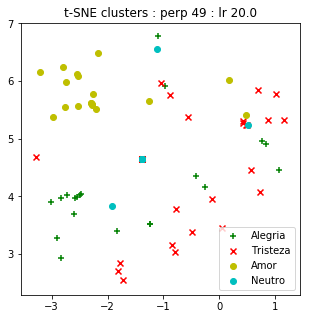

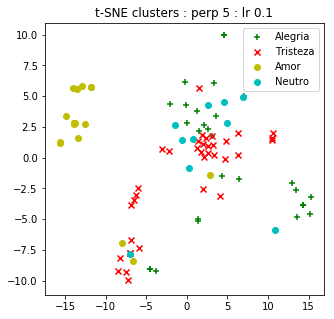

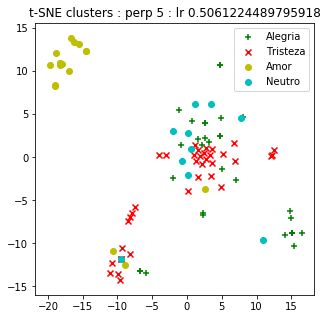

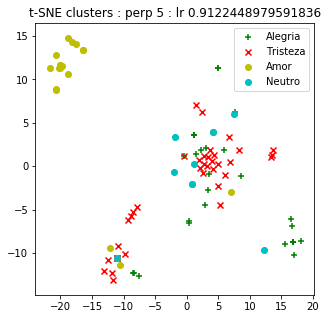

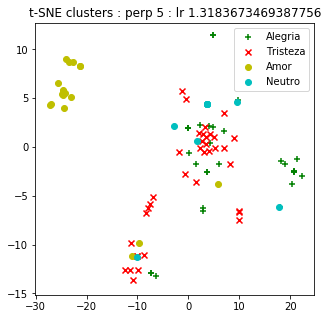

...

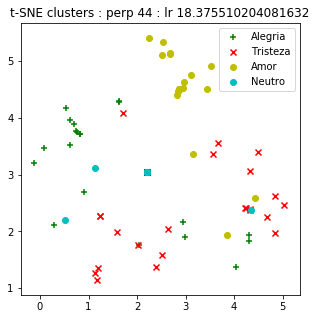

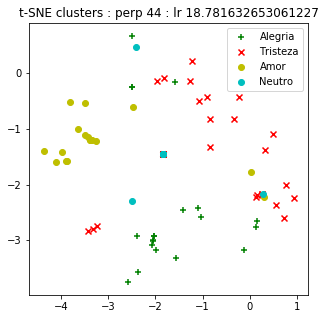

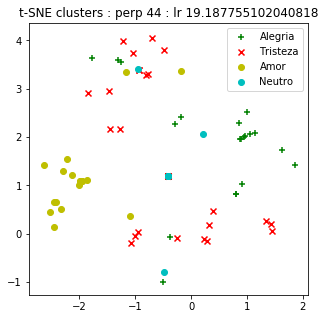

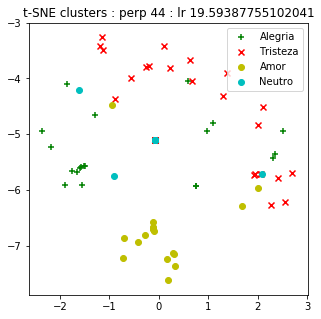

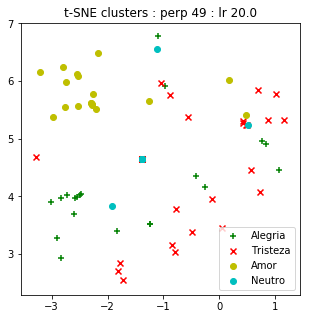

In [12]:
import time
for perp in range(5, 50):
    for lr in np.linspace(.1, 20, 50):
        J = TSNE(n_components=2, perplexity=perp, learning_rate=lr, random_state=0).fit_transform(X)

        sc_neutro = []
        sc_alegria = []
        sc_tristeza = []
        sc_amor = []
        for jk, frase in enumerate(frases):
            if frase in frases_felicidade_parsed:
                # print('ALEGRIA', frase, J[jk])
                sc_alegria.append(J[jk])
            if frase in frases_tristeza_parsed:
                # print('TRISTEZA', frase, J[jk])
                sc_tristeza.append(J[jk])
            if frase in frases_amor_parsed:
                # print('AMOR', frase, J[jk])
                sc_amor.append(J[jk])
            if frase in tweets:
                if 'POSITIVO' in sents1[jk-49]:
                    sc_alegria.append(J[jk])
                elif 'NEGATIVO' in sents1[jk-49]:
                    sc_tristeza.append(J[jk])
                else:
                    sc_neutro.append(J[jk])

        sc_alegria = np.asarray(sc_alegria)
        sc_tristeza = np.asarray(sc_tristeza)
        sc_amor = np.asarray(sc_amor)
        sc_neutro = np.asarray(sc_neutro)

        fig = plt.figure(figsize = (5, 5))
        c1 = plt.scatter(sc_alegria[:, 0], sc_alegria[:, 1], c='g', marker='+')
        c2 = plt.scatter(sc_tristeza[:, 0], sc_tristeza[:, 1], c='r', marker='x')
        c3 = plt.scatter(sc_amor[:, 0], sc_amor[:, 1], c='y', marker='o')
        c4 = plt.scatter(sc_neutro[:, 0], sc_neutro[:, 1], c='c', marker='o')
        plt.title(f't-SNE clusters : perp {perp} : lr {lr}')
        plt.legend([c1, c2, c3, c4], ['Alegria', 'Tristeza', 'Amor', 'Neutro'])
        # plt.show()
        display.clear_output(wait=True)
        display.display(pl.gcf())
        time.sleep(.3)

Na tentativa de validar se o cluster gerado pela redução de dimensionalidade proporcionado pelo algoritmo t-SNE possui alguma validade, aplicamos para cada perplexidade e learning rate uma validação dos próprios dados clusterizados usando SVM.

A ideia é, uma vez clusterizados, ao aplicar o algoritmo de SVM em parte destes dados, qual a acurácia atingida?

In [17]:
acc = []
tsne = []
for perp in range(3, 51):
    for lr in np.linspace(.5, 21, 10):
        J = TSNE(n_components=2, perplexity=perp, learning_rate=lr, random_state=0).fit_transform(X)
        sc_alegria, alegria_label = [], []
        sc_tristeza, tristeza_label = [], []
        sc_amor, amor_label = [], []
        sc_neutro, neutro_label = [], []
        for jk, frase in enumerate(frases):
            if frase in frases_felicidade_parsed:
                sc_alegria.append(J[jk])
                alegria_label.append('FELICIDADE')
            if frase in frases_tristeza_parsed:
                sc_tristeza.append( J[jk])
                tristeza_label.append('TRISTEZA')
            if frase in frases_amor_parsed:
                sc_amor.append(J[jk])
                amor_label.append('AMOR')
            if frase in tweets:
                if 'POSITIVO' in sents1[jk-49]:
                    sc_alegria.append(J[jk])
                    alegria_label.append('FELICIDADE')
                elif 'NEGATIVO' in sents1[jk-49]:
                    sc_tristeza.append(J[jk])
                    tristeza_label.append('TRISTEZA')
                else:
                    sc_neutro.append(J[jk])
                    neutro_label.append('NEUTRO')
        sc_alegria = np.asarray(sc_alegria)
        sc_tristeza = np.asarray(sc_tristeza)
        sc_amor = np.asarray(sc_amor)
        sc_neutro = np.asarray(sc_neutro)
        alegria_label = np.asarray(alegria_label)
        tristeza_label = np.asarray(tristeza_label)
        amor_label = np.asarray(amor_label)
        neutro_label = np.asarray(neutro_label)

        labels = np.append(np.append(np.append(alegria_label, tristeza_label), amor_label), neutro_label)

        md = SVC(kernel='rbf', gamma='scale', random_state=0, probability=True)
        md.fit(J, labels)

        print(f't-SNE clusters : perp {perp} : lr {lr}')
        print(f'Acurácia: {np.round(md.score(J, labels), 3) * 100}%')
        acc.append(np.round(md.score(J, labels), 3) * 100)
        tsne.append((perp, lr))

t-SNE clusters : perp 3 : lr 0.5
Acurácia: 76.8%
t-SNE clusters : perp 3 : lr 2.7777777777777777
Acurácia: 76.8%
t-SNE clusters : perp 3 : lr 5.055555555555555
Acurácia: 75.8%
t-SNE clusters : perp 3 : lr 7.333333333333333
Acurácia: 74.7%
t-SNE clusters : perp 3 : lr 9.61111111111111
Acurácia: 75.8%
t-SNE clusters : perp 3 : lr 11.88888888888889
Acurácia: 74.7%
t-SNE clusters : perp 3 : lr 14.166666666666666
Acurácia: 75.8%
t-SNE clusters : perp 3 : lr 16.444444444444443
Acurácia: 74.7%
t-SNE clusters : perp 3 : lr 18.72222222222222
Acurácia: 70.7%
t-SNE clusters : perp 3 : lr 21.0
Acurácia: 69.69999999999999%
t-SNE clusters : perp 4 : lr 0.5
Acurácia: 76.8%
t-SNE clusters : perp 4 : lr 2.7777777777777777
Acurácia: 78.8%
t-SNE clusters : perp 4 : lr 5.055555555555555
Acurácia: 78.8%
t-SNE clusters : perp 4 : lr 7.333333333333333
Acurácia: 78.8%
t-SNE clusters : perp 4 : lr 9.61111111111111
Acurácia: 78.8%
t-SNE clusters : perp 4 : lr 11.88888888888889
Acurácia: 77.8%
t-SNE clusters : p

t-SNE clusters : perp 16 : lr 7.333333333333333
Acurácia: 80.80000000000001%
t-SNE clusters : perp 16 : lr 9.61111111111111
Acurácia: 82.8%
t-SNE clusters : perp 16 : lr 11.88888888888889
Acurácia: 81.8%
t-SNE clusters : perp 16 : lr 14.166666666666666
Acurácia: 60.6%
t-SNE clusters : perp 16 : lr 16.444444444444443
Acurácia: 62.6%
t-SNE clusters : perp 16 : lr 18.72222222222222
Acurácia: 61.6%
t-SNE clusters : perp 16 : lr 21.0
Acurácia: 71.7%
t-SNE clusters : perp 17 : lr 0.5
Acurácia: 78.8%
t-SNE clusters : perp 17 : lr 2.7777777777777777
Acurácia: 87.9%
t-SNE clusters : perp 17 : lr 5.055555555555555
Acurácia: 65.7%
t-SNE clusters : perp 17 : lr 7.333333333333333
Acurácia: 82.8%
t-SNE clusters : perp 17 : lr 9.61111111111111
Acurácia: 66.7%
t-SNE clusters : perp 17 : lr 11.88888888888889
Acurácia: 84.8%
t-SNE clusters : perp 17 : lr 14.166666666666666
Acurácia: 63.6%
t-SNE clusters : perp 17 : lr 16.444444444444443
Acurácia: 67.7%
t-SNE clusters : perp 17 : lr 18.72222222222222
Acu

t-SNE clusters : perp 29 : lr 5.055555555555555
Acurácia: 65.7%
t-SNE clusters : perp 29 : lr 7.333333333333333
Acurácia: 64.60000000000001%
t-SNE clusters : perp 29 : lr 9.61111111111111
Acurácia: 66.7%
t-SNE clusters : perp 29 : lr 11.88888888888889
Acurácia: 60.6%
t-SNE clusters : perp 29 : lr 14.166666666666666
Acurácia: 60.6%
t-SNE clusters : perp 29 : lr 16.444444444444443
Acurácia: 62.6%
t-SNE clusters : perp 29 : lr 18.72222222222222
Acurácia: 61.6%
t-SNE clusters : perp 29 : lr 21.0
Acurácia: 60.6%
t-SNE clusters : perp 30 : lr 0.5
Acurácia: 82.8%
t-SNE clusters : perp 30 : lr 2.7777777777777777
Acurácia: 63.6%
t-SNE clusters : perp 30 : lr 5.055555555555555
Acurácia: 65.7%
t-SNE clusters : perp 30 : lr 7.333333333333333
Acurácia: 59.599999999999994%
t-SNE clusters : perp 30 : lr 9.61111111111111
Acurácia: 62.6%
t-SNE clusters : perp 30 : lr 11.88888888888889
Acurácia: 62.6%
t-SNE clusters : perp 30 : lr 14.166666666666666
Acurácia: 60.6%
t-SNE clusters : perp 30 : lr 16.44444

t-SNE clusters : perp 41 : lr 21.0
Acurácia: 59.599999999999994%
t-SNE clusters : perp 42 : lr 0.5
Acurácia: 36.4%
t-SNE clusters : perp 42 : lr 2.7777777777777777
Acurácia: 58.599999999999994%
t-SNE clusters : perp 42 : lr 5.055555555555555
Acurácia: 64.60000000000001%
t-SNE clusters : perp 42 : lr 7.333333333333333
Acurácia: 62.6%
t-SNE clusters : perp 42 : lr 9.61111111111111
Acurácia: 61.6%
t-SNE clusters : perp 42 : lr 11.88888888888889
Acurácia: 56.599999999999994%
t-SNE clusters : perp 42 : lr 14.166666666666666
Acurácia: 58.599999999999994%
t-SNE clusters : perp 42 : lr 16.444444444444443
Acurácia: 60.6%
t-SNE clusters : perp 42 : lr 18.72222222222222
Acurácia: 59.599999999999994%
t-SNE clusters : perp 42 : lr 21.0
Acurácia: 58.599999999999994%
t-SNE clusters : perp 43 : lr 0.5
Acurácia: 36.4%
t-SNE clusters : perp 43 : lr 2.7777777777777777
Acurácia: 63.6%
t-SNE clusters : perp 43 : lr 5.055555555555555
Acurácia: 62.6%
t-SNE clusters : perp 43 : lr 7.333333333333333
Acurácia: 

In [18]:
perp, lr = 1, .1
mmax = np.max(acc)
for kl, acci in enumerate(acc):
    if acci == mmax:
        perp, lr = tsne[kl]

J = TSNE(n_components=2, perplexity=perp, learning_rate=lr, random_state=0).fit_transform(X)
sc_alegria, alegria_label = [], []
sc_tristeza, tristeza_label = [], []
sc_amor, amor_label = [], []
sc_neutro, neutro_label = [], []
for jk, frase in enumerate(frases):
    if frase in frases_felicidade_parsed:
        sc_alegria.append(J[jk])
        alegria_label.append('FELICIDADE')
    if frase in frases_tristeza_parsed:
        sc_tristeza.append( J[jk])
        tristeza_label.append('TRISTEZA')
    if frase in frases_amor_parsed:
        sc_amor.append(J[jk])
        amor_label.append('AMOR')
    if frase in tweets:
        if 'POSITIVO' in sents1[jk-49]:
            sc_alegria.append(J[jk])
            alegria_label.append('FELICIDADE')
        elif 'NEGATIVO' in sents1[jk-49]:
            sc_tristeza.append(J[jk])
            tristeza_label.append('TRISTEZA')
        else:
            sc_neutro.append(J[jk])
            neutro_label.append('NEUTRO')
sc_alegria = np.asarray(sc_alegria)
sc_tristeza = np.asarray(sc_tristeza)
sc_amor = np.asarray(sc_amor)
sc_neutro = np.asarray(sc_neutro)
alegria_label = np.asarray(alegria_label)
tristeza_label = np.asarray(tristeza_label)
amor_label = np.asarray(amor_label)
neutro_label = np.asarray(neutro_label)

labels = np.append(np.append(np.append(alegria_label, tristeza_label), amor_label), neutro_label)

md = SVC(kernel='rbf', gamma='scale', random_state=0, probability=True)
md.fit(J, labels)

print(f'Acurácia: {np.round(md.score(J, labels), 3) * 100}%')

fig = plt.figure(figsize = (5, 5))
c1 = plt.scatter(sc_alegria[:, 0], sc_alegria[:, 1], c='g', marker='+')
c2 = plt.scatter(sc_tristeza[:, 0], sc_tristeza[:, 1], c='r', marker='x')
c3 = plt.scatter(sc_amor[:, 0], sc_amor[:, 1], c='y', marker='o')
c4 = plt.scatter(sc_neutro[:, 0], sc_neutro[:, 1], c='c', marker='o')
plt.title(f't-SNE clusters : perplexity = {perp}, learning_rate = {lr}')
plt.legend([c1, c2, c3, c4], ['Alegria', 'Tristeza', 'Amor', 'Neutro'])
plt.show()

for gh in range(len(J)):
    print(md.predict([J[gh]]))
    print(md.predict_proba([J[gh]]))


# weights_f = pd.DataFrame(np.round(md.predict_proba(J) * 100, 2))
# print(weights_f)

Acurácia: 92.9%


['FELICIDADE']
[[0.03179643 0.84736629 0.06184828 0.05898899]]
['FELICIDADE']
[[0.03181572 0.84733075 0.06190171 0.05895183]]
['FELICIDADE']
[[0.03180479 0.84724465 0.0619314  0.05901916]]
['FELICIDADE']
[[0.03183222 0.84727478 0.06189482 0.05899818]]
['FELICIDADE']
[[0.03182758 0.84730103 0.06191049 0.05896089]]
['FELICIDADE']
[[0.0318336  0.84728036 0.06191399 0.05897205]]
['FELICIDADE']
[[0.03181609 0.84731026 0.06190489 0.05896876]]
['FELICIDADE']
[[0.03183985 0.84721811 0.06194401 0.05899803]]
['FELICIDADE']
[[0.03186393 0.84710817 0.06195157 0.05907634]]
['FELICIDADE']
[[0.03181757 0.84728439 0.06192827 0.05896977]]
['FELICIDADE']
[[0.03179492 0.84729387 0.06190315 0.05900806]]
['FELICIDADE']
[[0.03181189 0.84729433 0.06190115 0.05899263]]
['FELICIDADE']
[[0.03014368 0.8315071  0.08479106 0.05355816]]
['FELICIDADE']
[[0.03183599 0.84724236 0.06191454 0.05900711]]
['FELICIDADE']
[[0.03185138 0.84725753 0.06185767 0.05903342]]
['FELICIDADE']
[[0.0313416  0.84962936 0.05991258 0.059

### TESTE

Para avaliar melhor o demonstrado acima, será utilizado o conjunto de palavras para valência POSITIVA, NEGATIVA e NEUTRA.

O conjuto de documentos que serão validados são os 40000 mil tweets, mas por questão de hardware, serão carregados apenas 2000 para validação.

In [19]:
print('Loading emotional words: ')
emotion_words = load_six_emotions('/home/rdenadai/vagrant/python-dev/sentiment-analysis-2018-president-election/dataset/emocoes')
emotion_words_n = load_3_emotions('/home/rdenadai/vagrant/python-dev/sentiment-analysis-2018-president-election/dataset/emocoes')
emotion_words['NEUTRO'] = emotion_words_n['NEUTRO']

Loading emotional words: 


In [20]:
# with open('/home/rdenadai/vagrant/python-dev/sentiment-analysis-2018-president-election/dataset/frases.txt') as h:
#     original_phrases = h.readlines()
# original_phrases = original_phrases[:1500]
# phrases = copy.deepcopy(original_phrases)

# phrases = [tokenizer(phrase) for phrase in phrases]
# ldocs = [f'D{i}' for i in range(len(phrases))]

original_tweets = []
sents = []
filename = '/home/rdenadai/vagrant/python-dev/sentiment-analysis-2018-president-election/dataset/tweets-tratados-polaridade-10-10-2018.csv'
with open(filename, 'r') as h:
    reader = csv.reader(h, delimiter='|')
    for row in reader:
        tweet = row[1]
        tweet_sent = row[2]
        if len(tweet) > 5:
            original_tweets += [tweet]
            sents += [tweet_sent]

print('Starting NLP clean up...')
phrases = copy.deepcopy(original_tweets[:2000])
phrases = [tokenizer(phrase) for phrase in phrases]
ldocs = [f'D{i}' for i in range(len(phrases))]

Starting NLP clean up...


In [21]:
# TF-IDF
vec_tfidf = TfidfVectorizer(ngram_range=(1, 1))
X_tfidf = vec_tfidf.fit_transform(phrases)
weights_tfidf = pd.DataFrame(np.round(X_tfidf.toarray().T, 5), index=vec_tfidf.get_feature_names(), columns=ldocs)

# TERM-DOCUMENT
vec_count = CountVectorizer(ngram_range=(1, 1))
X_count = vec_count.fit_transform(phrases)
weights_count = pd.DataFrame(np.round(X_count.toarray().T, 5), index=vec_count.get_feature_names(), columns=ldocs)

# Word2Vec
N_features = X_tfidf.shape[1]

frases_w2v = []
for frase in phrases:
    bigram = []
    p_frase = word_tokenize(frase)
    for m, palavra in enumerate(p_frase):
        next_p = None
        try:
            next_p = p_frase[m+1]
        except:
            pass
        bigram += [f'{palavra}']
    frases_w2v += [bigram]

model = gensim.models.Word2Vec(
    frases_w2v,
    sg=1,
    size=1,
    window=50,
    min_count=1,
    workers=10)
model.train(frases_w2v, total_examples=len(frases_w2v), epochs=1500)

(18516489, 20262000)

In [23]:
def retorn_palavras(palavras, size):
    r_words = {}
    for i, word in enumerate(palavras):
        if len(word) <= 0: continue
        for index, word2 in enumerate(weights_tfidf.index):
            if re.search(r'\b(%s)\b' % word, word2):
                try:
                    r_words[word2] = (weights_tfidf.iloc[index].values + weights_count.iloc[index].values) * model.wv[word2]
                except:
                    pass
    return r_words

size = len(phrases)
r_words = {
    **retorn_palavras(emotion_words_n['NEUTRO'], size),
    **retorn_palavras(emotion_words_n['POSITIVO'], size),
    **retorn_palavras(emotion_words_n['NEGATIVO'], size),
#     **retorn_palavras(emotion_words['NEUTRO'], size),
#     **retorn_palavras(emotion_words['ALEGRIA'], size),
#     **retorn_palavras(emotion_words['SURPRESA'], size),
#     **retorn_palavras(emotion_words['DESGOSTO'], size),
#     **retorn_palavras(emotion_words['MEDO'], size),
#     **retorn_palavras(emotion_words['RAIVA'], size),
#     **retorn_palavras(emotion_words['TRISTEZA'], size),
}

lwor = list(r_words.keys())
X = np.asarray(list(r_words.values()))
weights = pd.DataFrame(X, index=lwor)
X = X.T

In [24]:
acc = []
tsne = []
for perp in range(3, 10):
    for lr in np.linspace(1, 5, 10):
        J = TSNE(n_components=2, perplexity=perp, learning_rate=lr, random_state=0).fit_transform(X)
        
        features = []
        for jk in range(len(J)):
            features.append((J[jk], sents[jk]))
        shuffle(features)
        training, prediction = features[:int(len(features) * 0.7)], features[-int(len(features)*0.3):]
        
        train_data, train_labels, predict_data, predict_labels = [], [], [], []
        for train in training:
            train_data.append(train[0])
            train_labels.append(train[1])
        for predict in prediction:
            predict_data.append(predict[0])
            predict_labels.append(predict[1])
        
        md = SVC(kernel='rbf', gamma='scale', random_state=0, probability=True)
        md.fit(train_data, train_labels)

        print(f't-SNE clusters : perp {perp} : lr {lr}')
        print(f'Acurácia: {np.round(md.score(predict_data, predict_labels), 3) * 100}%')
        acc.append(np.round(md.score(predict_data, predict_labels), 3) * 100)
        tsne.append((perp, lr))

t-SNE clusters : perp 3 : lr 1.0
Acurácia: 74.7%
t-SNE clusters : perp 3 : lr 1.4444444444444444
Acurácia: 74.7%
t-SNE clusters : perp 3 : lr 1.8888888888888888
Acurácia: 75.8%
t-SNE clusters : perp 3 : lr 2.333333333333333
Acurácia: 74.2%
t-SNE clusters : perp 3 : lr 2.7777777777777777
Acurácia: 73.2%
t-SNE clusters : perp 3 : lr 3.2222222222222223
Acurácia: 75.2%
t-SNE clusters : perp 3 : lr 3.6666666666666665
Acurácia: 73.5%
t-SNE clusters : perp 3 : lr 4.111111111111111
Acurácia: 73.3%
t-SNE clusters : perp 3 : lr 4.555555555555555
Acurácia: 75.8%
t-SNE clusters : perp 3 : lr 5.0
Acurácia: 74.0%
t-SNE clusters : perp 4 : lr 1.0
Acurácia: 73.8%
t-SNE clusters : perp 4 : lr 1.4444444444444444
Acurácia: 70.8%
t-SNE clusters : perp 4 : lr 1.8888888888888888
Acurácia: 72.2%
t-SNE clusters : perp 4 : lr 2.333333333333333
Acurácia: 74.2%
t-SNE clusters : perp 4 : lr 2.7777777777777777
Acurácia: 75.3%
t-SNE clusters : perp 4 : lr 3.2222222222222223
Acurácia: 73.0%
t-SNE clusters : perp 4 :

In [28]:
perp, lr = 1, .1
mmax = np.max(acc)
for kl, acci in enumerate(acc):
    if acci == mmax:
        perp, lr = tsne[kl]
J = TSNE(n_components=2, perplexity=perp, learning_rate=lr, random_state=0).fit_transform(X)

In [29]:
fig = plt.figure(figsize = (5, 5))
for jk in range(len(J)):
    if sents[jk] == 'Neutral':
        c1 = plt.scatter(J[jk, 0], J[jk, 1], c='g', marker='+')
    elif sents[jk] == 'Positive':
        c2 = plt.scatter(J[jk, 0], J[jk, 1], c='b', marker='o')
    elif sents[jk] == 'Negative':
        c3 = plt.scatter(J[jk, 0], J[jk, 1], c='r', marker='x')
plt.legend([c1, c2, c3], ['Neutral', 'Positive', 'Negative'])
plt.title('t-SNE clusters')
plt.show()

In [30]:
for k in range(8):
    print(original_tweets[k], J[k, :])

WildCat, o robot de quatro patas que corre a 25km/hora -  [-2.154125   5.6196437]
Parem de olhar para o meu telemovel quando estou a tweetar :) [-2.5011458  1.7896835]
@scrismelo Porque ainda não acordaste?! [ -0.86375314 -15.66299   ]
@TejoPaulo boa opção! [-3.201329 14.403827]
RT @joaomhenrique: O corte nas pensões de sobrevivência é um incentivo às viúvas para que saiam da sua zona de conforto e arranjem um novo … [13.441055 15.610083]
@catie_mpc AI DEUS. VOU JA PÔR AQUILO. f-se, um Louis português é o meu fucking sonho [ 9.893697  15.5406685]
@joao_paquete fica com a tua opinião ahah [-7.50602    1.4406925]
@soutaosocial tens os links? [-0.6033848 29.170963 ]
